In [3]:
#import 
import os, sys
sys.path.insert(1, os.path.abspath(".."))


from models.autoencoder import *
from sklearn.manifold import TSNE
import pickle
import torch
import math
from torch import nn
import numpy as np
from matplotlib import pyplot as plt
from sklearn.decomposition import PCA, KernelPCA
#from autoencoder.plots import *
import os
from data_generation.utils.geom_utils import graph_distance
#from data_generation.plots import *
from settings.custom_settings import CustomSettings
from data_generation.generate_trajectory import Trajectory
from copy import deepcopy
from mpl_toolkits.mplot3d import axes3d
from training.train_ae import preprocessing
import pandas as pd
from matplotlib.path import Path
import matplotlib.patches as patches
os.environ['KMP_DUPLICATE_LIB_OK']='True'

In [6]:
LATENT_SPACE_DIM = 3 #TODO auto fetch

GRAPH_MODEL_PATH = "../saved_models/AE_graph_exp1"
EUCL_MODEL_PATH = "../saved_models/AE_eucl_exp0"
GRAPH_EXP_NAME = "experiment1"
EUCL_EXP_NAME = "experiment0"

In [8]:
#Load data and model
#TODO use better data structure

#GRAPH
with open(GRAPH_MODEL_PATH + '/test_data', 'rb') as file:
    X_test_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + '/train_data', 'rb') as file:
    X_train_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + '/nonoise_test_data', 'rb') as file:
    X_n_test_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + '/nonoise_train_data', 'rb') as file:
    X_n_train_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + "/test_data_traj", 'rb') as file:
    traj_test_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + "/train_data_traj", 'rb') as file:
    traj_train_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + "/test_maze_config", 'rb') as file:
    test_maze_config_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + "/train_maze_config", 'rb') as file:
    train_maze_config_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + "/train_edge", 'rb') as file:
    train_edge_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + "/test_edge", 'rb') as file:
    test_edge_g = pickle.load(file)
with open(GRAPH_MODEL_PATH + "/loss_logs", 'rb') as file:
    loss_logs_g = pickle.load(file)

path = "../data_generation/generated_data/" + GRAPH_EXP_NAME
with open(path + "/maze.pkl", 'rb') as file:
    maze = pickle.load(file) #Maze is common to both
with open(path + "/trajectory.pkl", 'rb') as file:
    traj_g = pickle.load(file)
with open(path + "/placeCells.pkl", 'rb') as file:
    placeCells_g = pickle.load(file)
    
#EUCL
with open(EUCL_MODEL_PATH + '/test_data', 'rb') as file:
    X_test_e = pickle.load(file)
with open(EUCL_MODEL_PATH + '/train_data', 'rb') as file:
    X_train_e = pickle.load(file)
with open(EUCL_MODEL_PATH + '/nonoise_test_data', 'rb') as file:
    X_n_test_e = pickle.load(file)
with open(EUCL_MODEL_PATH + '/nonoise_train_data', 'rb') as file:
    X_n_train_e = pickle.load(file)
with open(EUCL_MODEL_PATH + "/test_data_traj", 'rb') as file:
    traj_test_e = pickle.load(file)
with open(EUCL_MODEL_PATH + "/train_data_traj", 'rb') as file:
    traj_train_e = pickle.load(file)
with open(EUCL_MODEL_PATH + "/test_maze_config", 'rb') as file:
    test_maze_config_e = pickle.load(file)
with open(EUCL_MODEL_PATH + "/train_maze_config", 'rb') as file:
    train_maze_config_e = pickle.load(file)
with open(EUCL_MODEL_PATH + "/train_edge", 'rb') as file:
    train_edge_e = pickle.load(file)
with open(EUCL_MODEL_PATH + "/test_edge", 'rb') as file:
    test_edge_e = pickle.load(file)
with open(EUCL_MODEL_PATH + "/loss_logs", 'rb') as file:
    loss_logs_e = pickle.load(file)

path = "../data_generation/generated_data/" + EUCL_EXP_NAME
with open(path + "/trajectory.pkl", 'rb') as file:
    traj_e = pickle.load(file)
with open(path + "/placeCells.pkl", 'rb') as file:
    placeCells_e = pickle.load(file)
    


In [9]:
with open('../rel_graph_distance/dge', 'rb') as file:
    dge = pickle.load(file)

In [10]:
with open('../rel_graph_distance/dgg', 'rb') as file:
    dgg = pickle.load(file)

In [11]:
#check hyp
print(placeCells_g.hyp == "graph")
print(placeCells_e.hyp == "euclidean")

True
True


In [12]:
#load model
with open(GRAPH_MODEL_PATH + "/model", 'rb') as file:
    graph_model = pickle.load(file)
with open(EUCL_MODEL_PATH + "/model", 'rb') as file:
    eucl_model = pickle.load(file)

graph_model.eval()
eucl_model.eval()

latent_space_test_g = graph_model.encoder(X_test_g)
latent_space_test_e = eucl_model.encoder(X_test_e)
latent_space_train_g = graph_model.encoder(X_train_g)
latent_space_train_e = eucl_model.encoder(X_train_e)
rec_test_g = graph_model.decoder(latent_space_test_g)
rec_test_e = eucl_model.decoder(latent_space_test_e)
rec_train_g = graph_model.decoder(latent_space_train_g)
rec_train_e = eucl_model.decoder(latent_space_train_e)

## FCTs

In [13]:
def lighten_color(color, amount=0.5):
    """
    Lightens the given color by multiplying (1-luminosity) by the given amount.
    Input can be matplotlib color string, hex string, or RGB tuple.

    Examples:
    >> lighten_color('g', 0.3)
    >> lighten_color('#F034A3', 0.6)
    >> lighten_color((.3,.55,.1), 0.5)
    """
    import matplotlib.colors as mc
    import colorsys
    try:
        c = mc.cnames[color]
    except:
        c = color
    c = colorsys.rgb_to_hls(*mc.to_rgb(c))
    return colorsys.hls_to_rgb(c[0], 1 - amount * (1 - c[1]), c[2])

In [14]:
#useful plotting functions
def ax_plot_traj(ax, traj_x_array, traj_y_array, maze, config, traj_col, maze_color="Greens", s_color="y"):
    #ax.title(title)
    col = sns.color_palette("colorblind")  
    ax.plot(traj_x_array, traj_y_array, color = traj_col)
    ax.plot(traj_x_array[0], traj_y_array[0], 'o', color = s_color)
    ax.plot(traj_x_array[-1], traj_y_array[-1], 'v', color = s_color)
    ax.set_xlim([0, maze.N])
    ax.set_ylim([0, maze.N])
    ax.grid()
    
        
        
def ax_plot_maze(ax, maze, config, plot_goals=[True, True, True], plot_home=True, maze_col = "Greys", ls = "-", hatch = None):
    col = sns.color_palette("colorblind")  
    patch = patches.PathPatch(maze.trialOctoMaze[config], facecolor='None', lw=3, linestyle = ls, hatch=hatch)
    ax.add_patch(patch)
    ax.imshow(maze.trialMazeFlags[config, ::-1], cmap=maze_col, extent=[0, maze.N, 0, maze.N], alpha=0.1)
    h = np.array(maze.nodeList[config]["A"]) + 0.5
    if plot_home:
        ax.scatter(h[0], h[1], s = 500, alpha = 1, marker = "P", color = col[0])
    for k in range(3): #goals
        gg = ["C", "D", "E"]
        if plot_goals[k]:
            g = np.array(maze.nodeList[config][gg[k]])+0.5
            ax.scatter(g[0], g[1], s = 500, color = col[k+2], marker = "8", alpha= 0.5) 

In [15]:
#useful trajectory functions
def extract_lat_space_trajectory(traj, goal, maze_config, pc, model):
    idx = np.where((np.array(traj.edge_position) == goal) & (np.array(traj.corr_maze_config) == maze_config))[0][1]
    neural_activity = np.log(pc.firingRates[traj.traj_cut_idx[idx]:traj.traj_cut_idx[idx+1], :]/pc.nu_max*(math.e-1)+1)
    
    return model.encoder(torch.Tensor(neural_activity))   

def extract_maze_trajectory(traj, goal, maze_config):
    idx = np.where((np.array(traj.edge_position) == goal) & (np.array(traj.corr_maze_config) == maze_config))[0][1]
    traj_x = traj.x_traj[traj.traj_cut_idx[idx]:traj.traj_cut_idx[idx+1]]
    traj_y = traj.y_traj[traj.traj_cut_idx[idx]:traj.traj_cut_idx[idx+1]]
    
    return traj_x, traj_y

# Latent space

In [16]:
#EUCLIDEAN
maze_config_e =train_maze_config_e #np.append(train_maze_config_e, test_maze_config_e,  axis = 0)
edge_e = train_edge_e #np.append(train_edge_e, test_edge_e,  axis = 0)
latent_space_e = latent_space_train_e.detach().numpy() #np.append(latent_space_train_e.detach().numpy(), latent_space_test_e.detach().numpy(), axis = 0)
traj_tot_e = traj_train_e #np.append(traj_train_e, traj_test_e,  axis = 0)

#GRAPH
maze_config_g = train_maze_config_g #np.append(train_maze_config_g, test_maze_config_g,  axis = 0)
edge_g = train_edge_g #np.append(train_edge_g, test_edge_g,  axis = 0)
latent_space_g = latent_space_train_g.detach().numpy() #np.append(latent_space_train_g.detach().numpy(), latent_space_test_g.detach().numpy(), axis = 0)
traj_tot_g = traj_train_g #np.append(traj_train_g, traj_test_g,  axis = 0)


# Losses and reconstruction

In [17]:
FRe = placeCells_e.generate_firing_rates(traj_e, maze)
FRe = FRe[traj_e.traj_cut_idx[0]:traj_e.traj_cut_idx[3]]
prepData = torch.Tensor(np.log(FRe/placeCells_e.nu_max * (math.e - 1) + 1))
recFRe  = eucl_model(prepData)
recFRe = recFRe.detach().numpy()

0/150
1/150
2/150
3/150
4/150
5/150
6/150
7/150
8/150
9/150
10/150
11/150
12/150
13/150
14/150
15/150
16/150
17/150
18/150
19/150
20/150
21/150
22/150
23/150
24/150
25/150
26/150
27/150
28/150
29/150
30/150
31/150
32/150
33/150
34/150
35/150
36/150
37/150
38/150
39/150
40/150
41/150
42/150
43/150
44/150
45/150
46/150
47/150
48/150
49/150
50/150
51/150
52/150
53/150
54/150
55/150
56/150
57/150
58/150
59/150
60/150
61/150
62/150
63/150
64/150
65/150
66/150
67/150
68/150
69/150
70/150
71/150
72/150
73/150
74/150
75/150
76/150
77/150
78/150
79/150
80/150
81/150
82/150
83/150
84/150
85/150
86/150
87/150
88/150
89/150
90/150
91/150
92/150
93/150
94/150
95/150
96/150
97/150
98/150
99/150
100/150
101/150
102/150
103/150
104/150
105/150
106/150
107/150
108/150
109/150
110/150
111/150
112/150
113/150
114/150
115/150
116/150
117/150
118/150
119/150
120/150
121/150
122/150
123/150
124/150
125/150
126/150
127/150
128/150
129/150
130/150
131/150
132/150
133/150
134/150
135/150
136/150
137/150
138/15

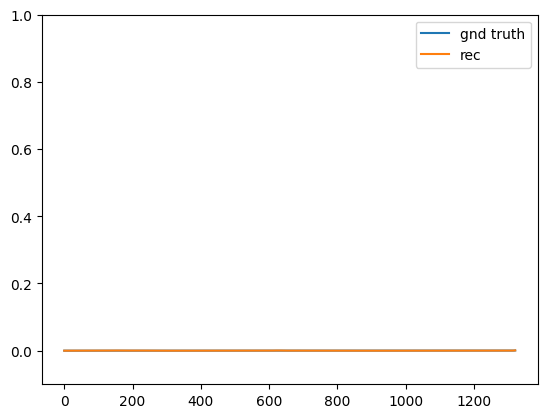

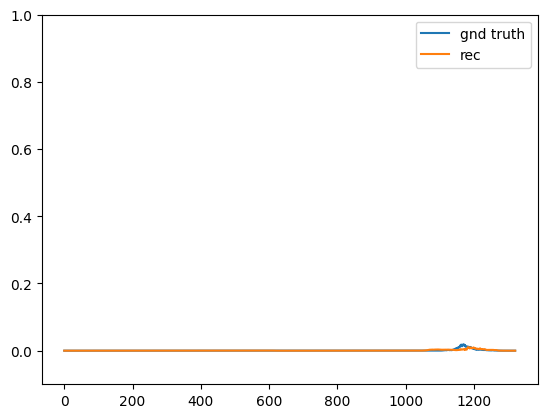

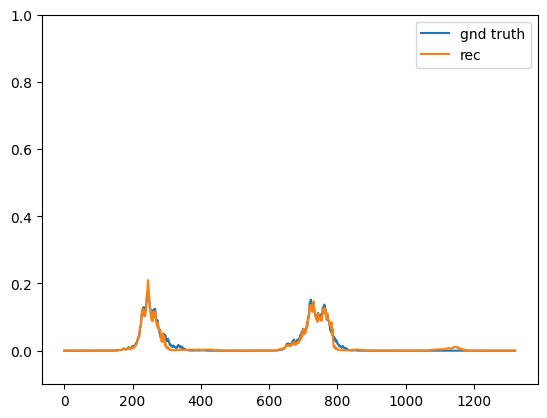

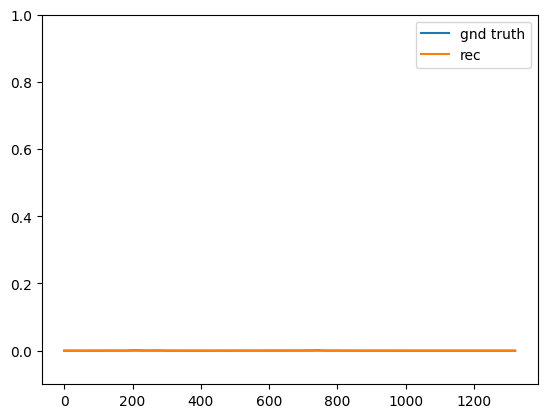

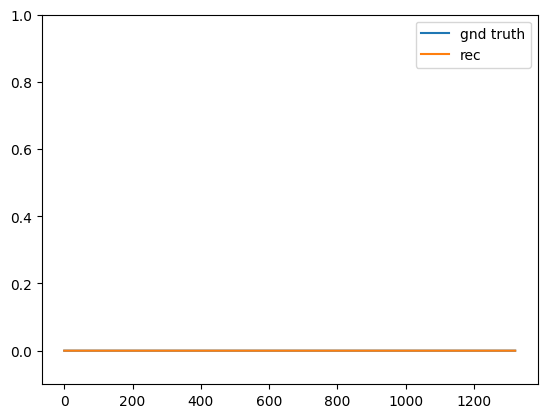

...

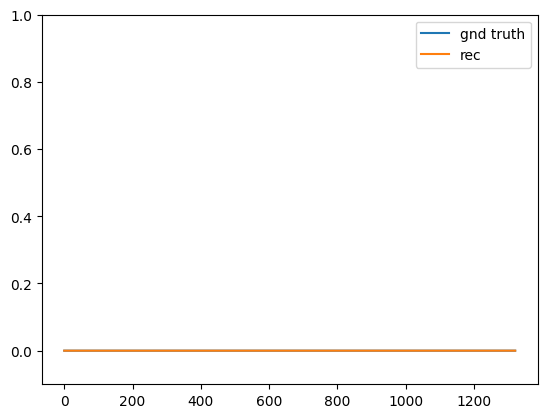

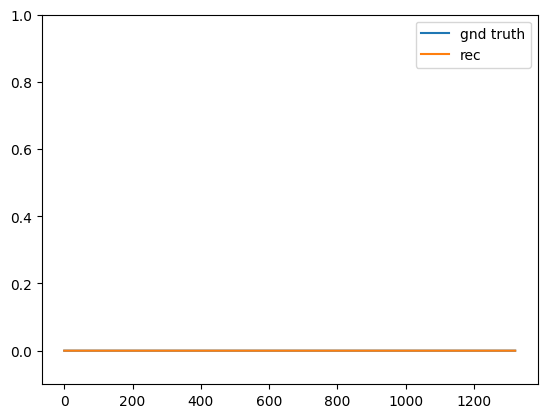

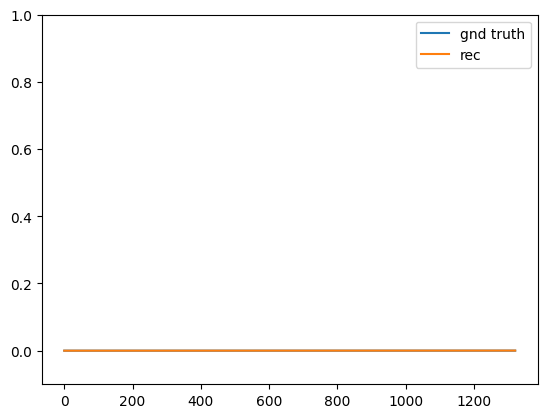

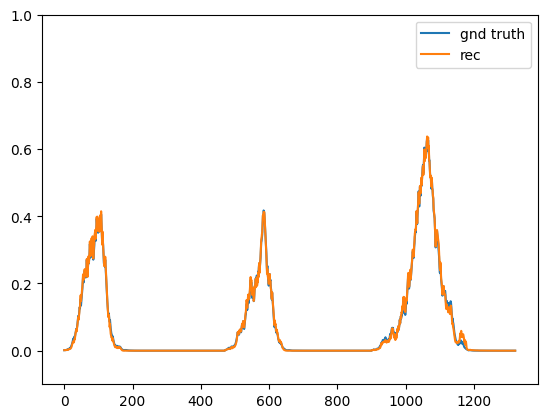

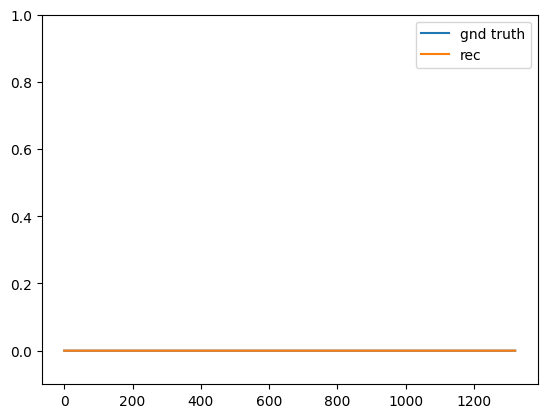

In [18]:
for i in range(50):
    plt.plot(prepData[:, i], label = "gnd truth")
    plt.plot(recFRe[:, i], label = "rec")
    plt.ylim([-0.1, 1])
    plt.legend()
    plt.show()

In [19]:
FRg = placeCells_g.generate_firing_rates(traj_g, maze)
FRg = FRg[traj_g.traj_cut_idx[0]:traj_g.traj_cut_idx[3]]
prepData = torch.Tensor(np.log(FRg/placeCells_g.nu_max * (math.e - 1) + 1))
recFRg  = graph_model(prepData)
recFRg = recFRg.detach().numpy()

0/150
1/150
2/150
3/150
4/150
5/150
6/150
7/150
8/150
9/150
10/150
11/150
12/150
13/150
14/150
15/150
16/150
17/150
18/150
19/150
20/150
21/150
22/150
23/150
24/150
25/150
26/150
27/150
28/150
29/150
30/150
31/150
32/150
33/150
34/150
35/150
36/150
37/150
38/150
39/150
40/150
41/150
42/150
43/150
44/150
45/150
46/150
47/150
48/150
49/150
50/150
51/150
52/150
53/150
54/150
55/150
56/150
57/150
58/150
59/150
60/150
61/150
62/150
63/150
64/150
65/150
66/150
67/150
68/150
69/150
70/150
71/150
72/150
73/150
74/150
75/150
76/150
77/150
78/150
79/150
80/150
81/150
82/150
83/150
84/150
85/150
86/150
87/150
88/150
89/150
90/150
91/150
92/150
93/150
94/150
95/150
96/150
97/150
98/150
99/150
100/150
101/150
102/150
103/150
104/150
105/150
106/150
107/150
108/150
109/150
110/150
111/150
112/150
113/150
114/150
115/150
116/150
117/150
118/150
119/150
120/150
121/150
122/150
123/150
124/150
125/150
126/150
127/150
128/150
129/150
130/150
131/150
132/150
133/150
134/150
135/150
136/150
137/150
138/15

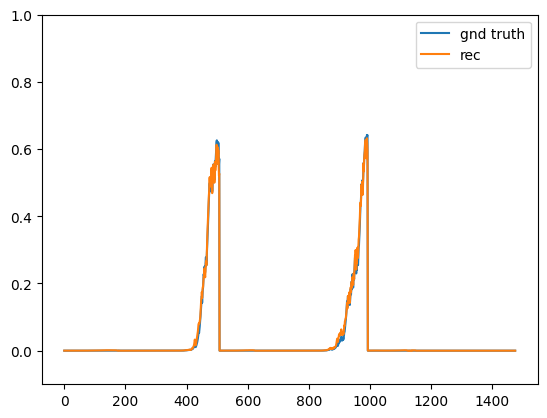

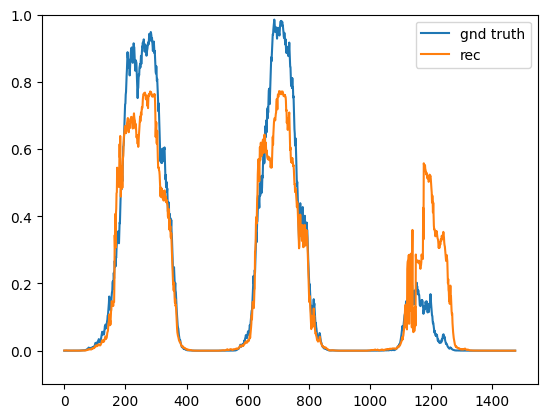

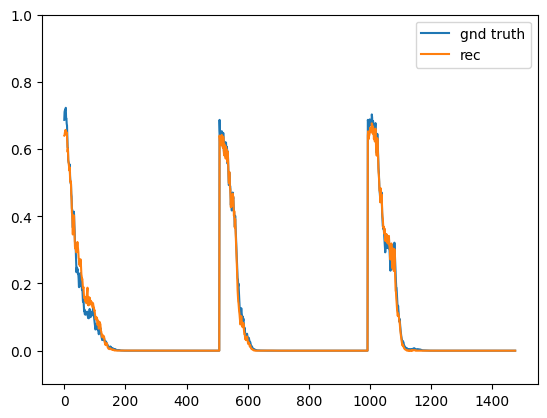

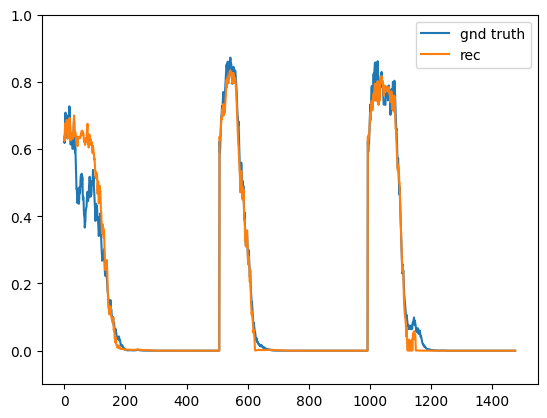

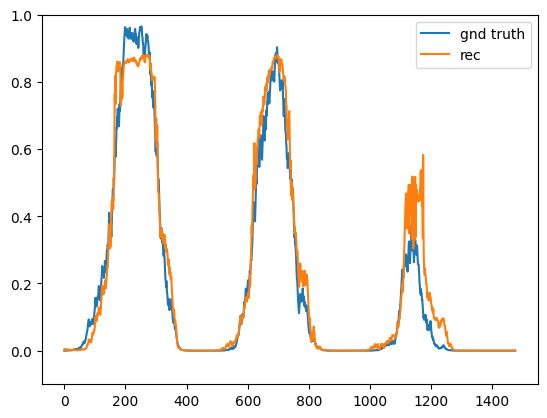

...

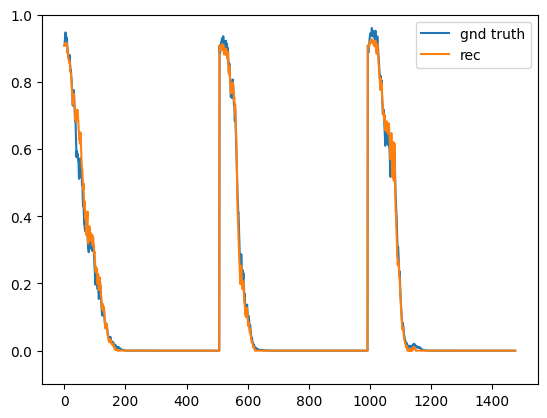

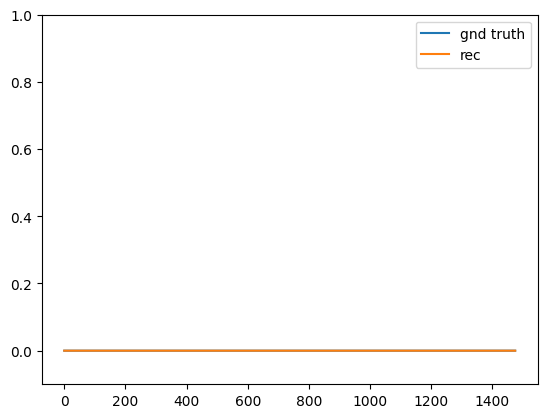

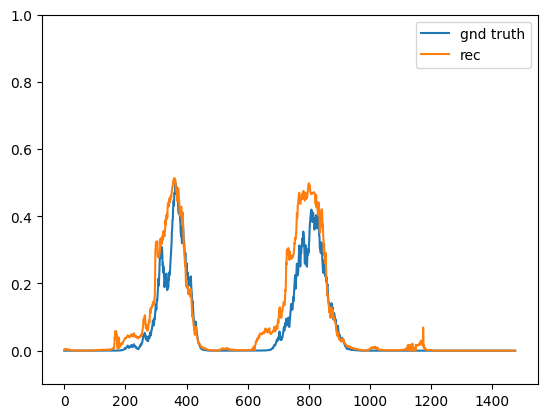

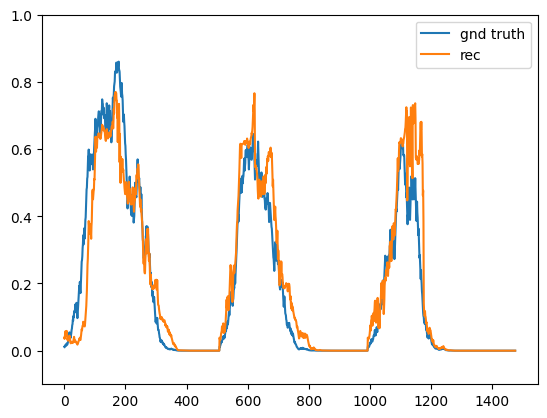

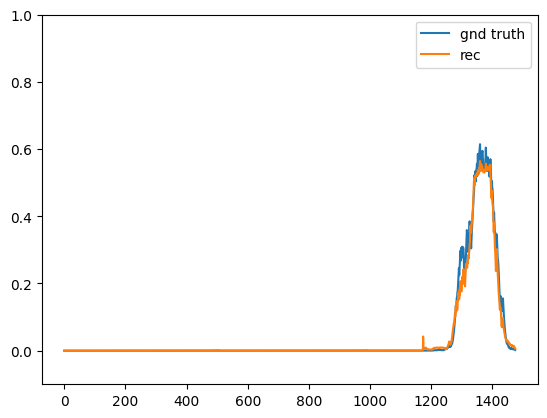

In [20]:
for i in range(50):
    plt.plot(prepData[:, i], label = "gnd truth")
    plt.plot(recFRg[:, i], label = "rec")
    plt.ylim([-0.1, 1])
    plt.legend()
    plt.show()

## 2D PCA

In [21]:
pca_e = PCA(n_components=2, whiten=True)
pca_e.fit(latent_space_e)
latent_space_e_2d = pca_e.transform(latent_space_e)
print(np.sum(pca_e.explained_variance_ratio_))

0.8839079642048195


In [22]:
pca_g = PCA(n_components=2, whiten=True)
pca_g.fit(latent_space_g)
latent_space_g_2d = pca_g.transform(latent_space_g)
print(np.sum(pca_g.explained_variance_ratio_))

0.9981958377601352


## Latent space Viz

Text(0, 0.5, 'Principal component 2')

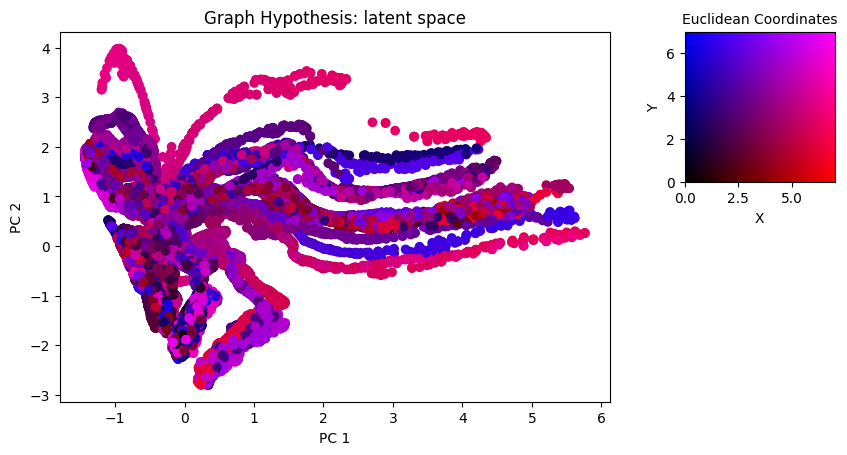

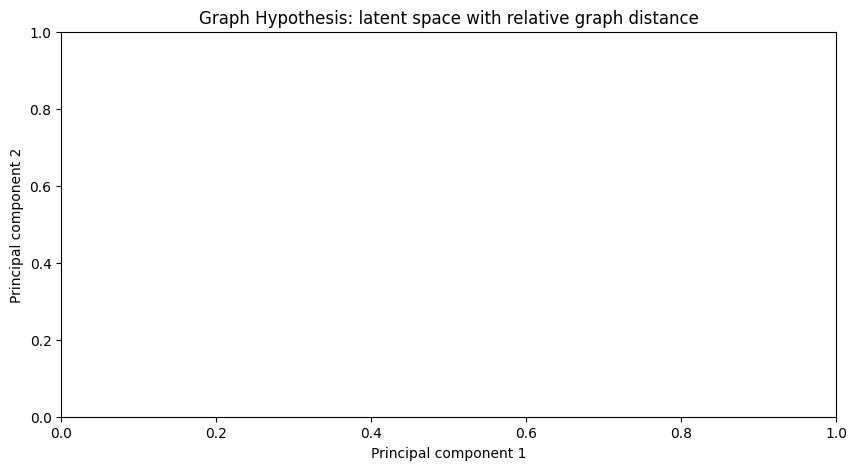

In [23]:
SAMPLE_SIZE = len(latent_space_g_2d)
idx = np.random.choice(len(latent_space_g_2d), SAMPLE_SIZE)

#x-y coord color scale
col = np.zeros((3, traj_tot_g [idx].shape[0]))
col[0, :] =  traj_tot_g[idx, 0]
col[2, :] =  traj_tot_g[idx, 1]
col = col/7

#Figure wrt Eucl coord:
fig = plt.figure(figsize = (10, 5))
ax1 = fig.add_subplot(1,1,1)
plt.title("Graph Hypothesis: latent space")
plt.xlabel("PC 1")
plt.ylabel("PC 2")

ax1.scatter(latent_space_g_2d[idx, 0], latent_space_g_2d[idx, 1], c=col.T)
plt.subplots_adjust(left=0.2, right=0.75, top=0.85)

#legend plot
cax = fig.add_axes([0.75,0.55,0.3,0.3])
cp1 = np.linspace(0,1)
cp2 = np.linspace(0,1)
Cp1, Cp2 = np.meshgrid(cp1,cp2)
C0 = np.zeros_like(Cp1)# make RGB image, p1 to red channel, p2 to blue channel
Legend = np.dstack((Cp1, C0, Cp2))

# parameters range between 0 and 7
cax.imshow(Legend, origin="lower", extent=[0,7,0,7])
cax.set_xlabel("X")
cax.set_ylabel("Y")
cax.set_title("Euclidean Coordinates", fontsize=10)

################################
#Figure wrt norm graph distance
fig = plt.figure(figsize = (10, 5))
ax1 = fig.add_subplot(1,1,1)
plt.title("Graph Hypothesis: latent space with relative graph distance")
#im = ax1.scatter(latent_space_g_2d[idx, 0], latent_space_g_2d[idx, 1], c=dgg[idx])
plt.xlabel("Principal component 1")
plt.ylabel("Principal component 2")
#cbar = plt.colorbar(im, ax = ax1)
#cbar.set_label("Graph dist from home")



Text(0, 0.5, 'Principal component 2')

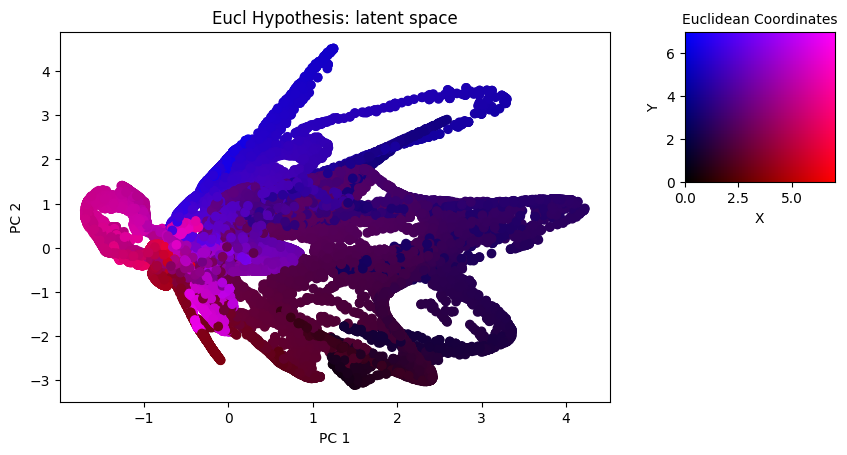

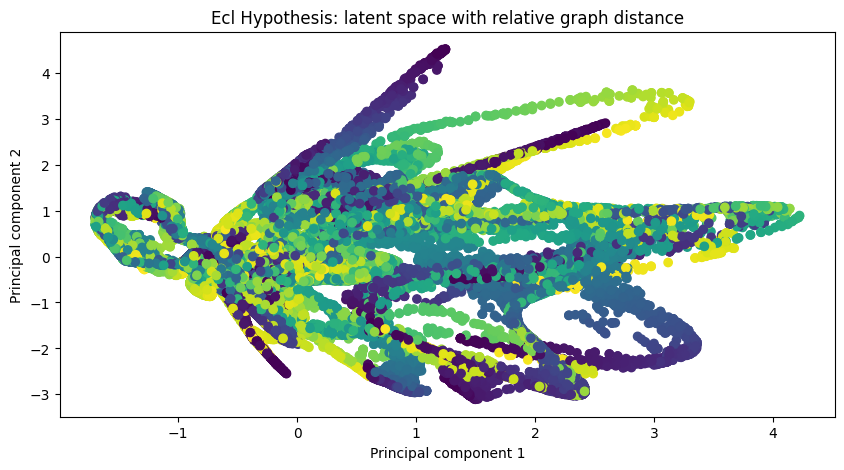

In [24]:
SAMPLE_SIZE = len(latent_space_e_2d)
idx = np.random.choice(len(latent_space_e_2d), SAMPLE_SIZE)

#x-y coord color scale
col = np.zeros((3, traj_tot_e[idx].shape[0]))
col[0, :] =  traj_tot_e[idx, 0]
col[2, :] =  traj_tot_e[idx, 1]
col = col/7

#Figure wrt Eucl coord:
fig = plt.figure(figsize = (10, 5))
ax1 = fig.add_subplot(1,1,1)
plt.title("Eucl Hypothesis: latent space")
plt.xlabel("PC 1")
plt.ylabel("PC 2")

ax1.scatter(latent_space_e_2d[idx, 0], latent_space_e_2d[idx, 1], c=col.T)
plt.subplots_adjust(left=0.2, right=0.75, top=0.85)

#legend plot
cax = fig.add_axes([0.75,0.55,0.3,0.3])
cp1 = np.linspace(0,1)
cp2 = np.linspace(0,1)
Cp1, Cp2 = np.meshgrid(cp1,cp2)
C0 = np.zeros_like(Cp1)# make RGB image, p1 to red channel, p2 to blue channel
Legend = np.dstack((Cp1, C0, Cp2))

# parameters range between 0 and 7
cax.imshow(Legend, origin="lower", extent=[0,7,0,7])
cax.set_xlabel("X")
cax.set_ylabel("Y")
cax.set_title("Euclidean Coordinates", fontsize=10)

################################
#Figure wrt norm graph distance
fig = plt.figure(figsize = (10, 5))
ax1 = fig.add_subplot(1,1,1)
plt.title("Ecl Hypothesis: latent space with relative graph distance")
im = ax1.scatter(latent_space_e_2d[idx, 0], latent_space_e_2d[idx, 1], c=dge[idx])
plt.xlabel("Principal component 1")
plt.ylabel("Principal component 2")
#cbar = plt.colorbar(im, ax = ax1)
#cbar.set_label("Graph dist from home")



In [25]:
import seaborn as sns
col = sns.color_palette("colorblind")
col

[(0.00392156862745098, 0.45098039215686275, 0.6980392156862745),
 (0.8705882352941177, 0.5607843137254902, 0.0196078431372549),
 (0.00784313725490196, 0.6196078431372549, 0.45098039215686275),
 (0.8352941176470589, 0.3686274509803922, 0.0),
 (0.8, 0.47058823529411764, 0.7372549019607844),
 (0.792156862745098, 0.5686274509803921, 0.3803921568627451),
 (0.984313725490196, 0.6862745098039216, 0.8941176470588236),
 (0.5803921568627451, 0.5803921568627451, 0.5803921568627451),
 (0.9254901960784314, 0.8823529411764706, 0.2),
 (0.33725490196078434, 0.7058823529411765, 0.9137254901960784)]

<Figure size 640x480 with 0 Axes>

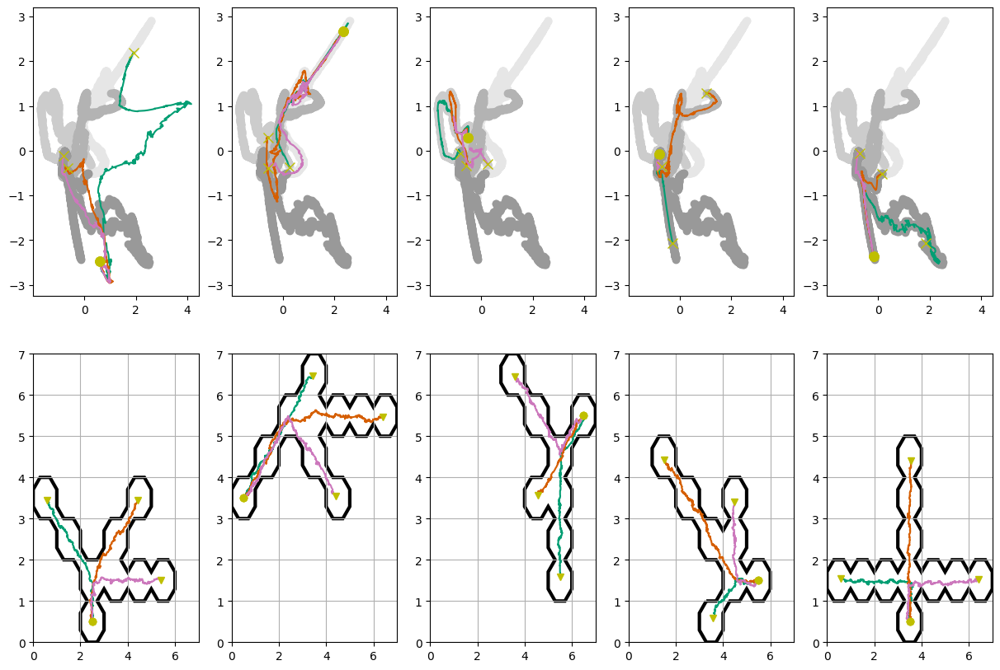

In [26]:
n_maze=5

#Plot trajectories in latent space
#EUCL
plt.figure()
fig, axs = plt.subplots(2, n_maze, figsize = (15, 10))
for k in range(5): #maze config
        #idx = np.where(maze_config_e == k)
    home = maze.nodeList[k]["A"]
    idx = np.where(maze_config_e == k)
    patch = patches.PathPatch(maze.trialOctoMaze[k], facecolor='None', lw=3)
    axs[1, k].add_patch(patch)
    
    for m in range(5):
        im = axs[0, m].scatter(latent_space_e_2d[idx, 0], latent_space_e_2d[idx, 1], color=lighten_color("grey",k*0.2))
    
    for g in range(3): #goal edge
        traj_act_latent = extract_lat_space_trajectory(traj_e, goal=g, maze_config=k, pc=placeCells_e, model= eucl_model)
        
        traj_act_latent= pca_e.transform(traj_act_latent.detach().numpy())

        axs[0, k].plot(traj_act_latent[:, 0], traj_act_latent[:, 1], c=col[g+2], label = "maze %s, goal %s"%(k, g))
        axs[0, k].plot(traj_act_latent[0, 0], traj_act_latent[0, 1], 'yo', markersize = 8)
        axs[0, k].plot(traj_act_latent[-1, 0], traj_act_latent[-1, 1], 'yx',  markersize = 8)        
        
        
        traj_x_array, traj_y_array = extract_maze_trajectory(traj_e, g, k)
        ax_plot_traj(axs[1, k], traj_x_array, traj_y_array, maze, k, traj_col = col[g+2])
        


<Figure size 640x480 with 0 Axes>

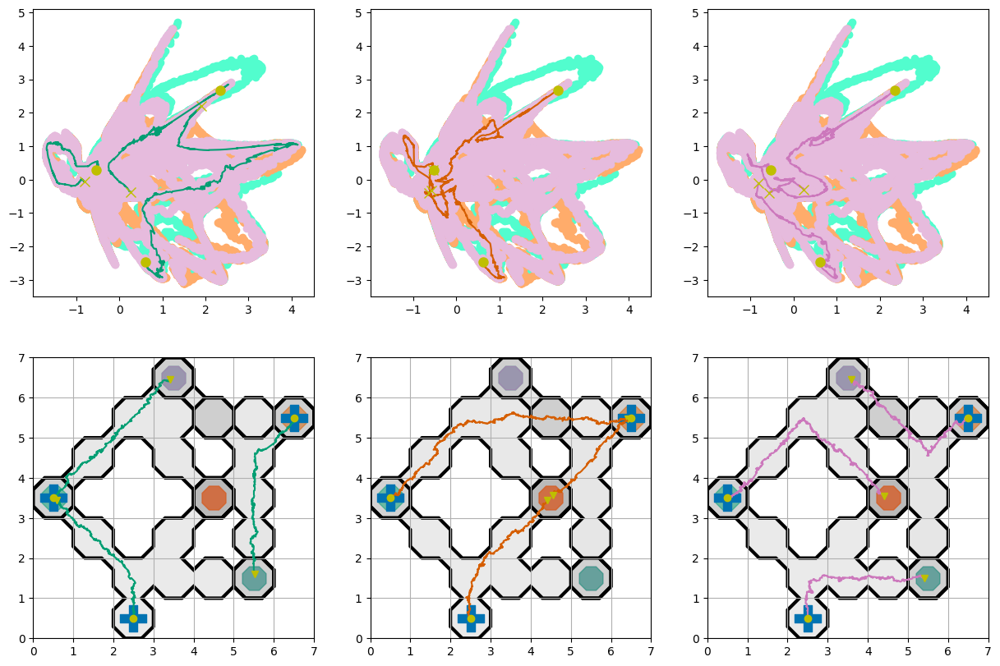

In [27]:
###EUCL
plt.figure()
fig, axs = plt.subplots(2, 3, figsize = (15, 10))

for g in range(3): #goal edge
    idx_g = np.where(edge_e == g)
    for m in range(3):        
        im = axs[0, m].scatter(latent_space_e_2d[idx_g, 0], latent_space_e_2d[idx_g, 1], alpha = 1, color = lighten_color(col[g+2]))

    for k in range(3): #maze config
        traj_act_latent = extract_lat_space_trajectory(traj_e, goal=g, maze_config=k, pc=placeCells_e, model= eucl_model)
        traj_act_latent= pca_e.transform(traj_act_latent.detach().numpy())

        axs[0, g].plot(traj_act_latent[:, 0], traj_act_latent[:, 1], label = "maze %s, goal %s"%(k, g), c=col[g+2])
        axs[0, g].plot(traj_act_latent[0, 0], traj_act_latent[0, 1], 'yo', markersize = 8)
        axs[0, g].plot(traj_act_latent[-1, 0], traj_act_latent[-1, 1], 'yx',  markersize = 8)

        traj_x_array, traj_y_array = extract_maze_trajectory(traj_e, g, k)
        ax_plot_traj(axs[1, g], traj_x_array, traj_y_array, maze, k, traj_col = col[g+2])#, maze_color = colors[k])

        #patch = patches.PathPatch(maze.trialOctoMaze[k], facecolor='None', lw=3)
        #axs[1, g].add_patch(patch)
        ax_plot_maze(axs[1, g], maze, k)



<Figure size 640x480 with 0 Axes>

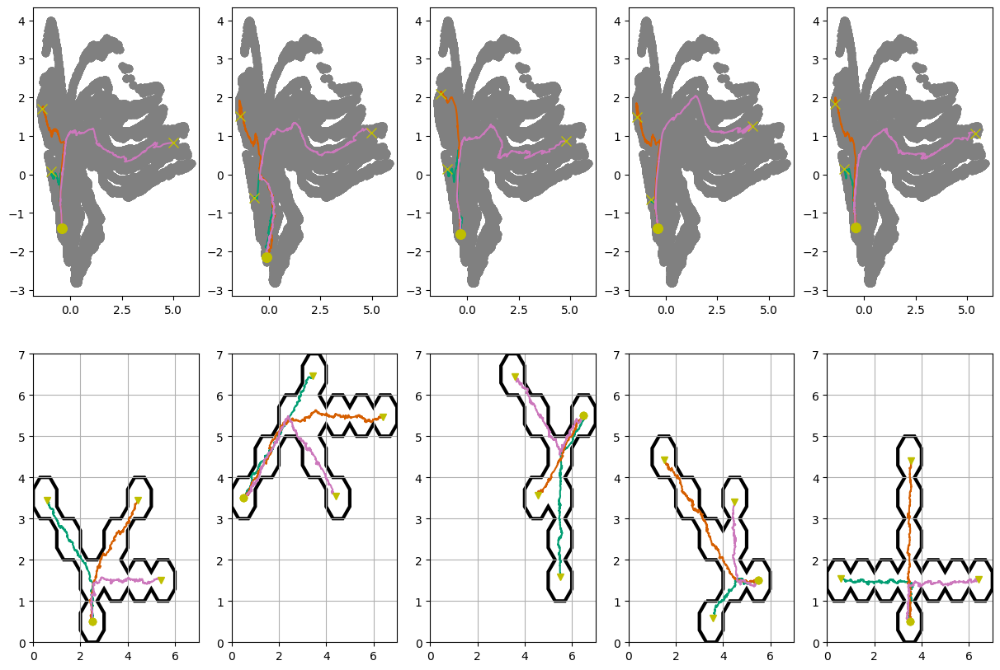

In [28]:
n_maze=5
#Plot trajectories in latent space
#GRAPH
plt.figure()
fig, axs = plt.subplots(2, n_maze, figsize = (15, 10))
for k in range(n_maze): #maze config
        #idx = np.where(maze_config_e == k)
    home = maze.nodeList[k]["A"]
    idx = np.where(maze_config_g == k)
    patch = patches.PathPatch(maze.trialOctoMaze[k], facecolor='None', lw=3)
    axs[1, k].add_patch(patch)
    
    for m in range(n_maze):
        im = axs[0, m].scatter(latent_space_g_2d[:, 0], latent_space_g_2d[:, 1], c="grey")
    
    for g in range(3): #goal edge
        traj_act_latent = extract_lat_space_trajectory(traj_g, goal=g, maze_config=k, pc=placeCells_g, model= graph_model)
        
        traj_act_latent= pca_g.transform(traj_act_latent.detach().numpy())

        axs[0, k].plot(traj_act_latent[:, 0], traj_act_latent[:, 1], c=col[g+2], label = "maze %s, goal %s"%(k, g))
        axs[0, k].plot(traj_act_latent[0, 0], traj_act_latent[0, 1], 'yo', markersize = 8)
        axs[0, k].plot(traj_act_latent[-1, 0], traj_act_latent[-1, 1], 'yx',  markersize = 8)        
        
        
        traj_x_array, traj_y_array = extract_maze_trajectory(traj_e, g, k)
        ax_plot_traj(axs[1, k], traj_x_array, traj_y_array, maze, k, traj_col = col[g+2])
    

<Figure size 640x480 with 0 Axes>

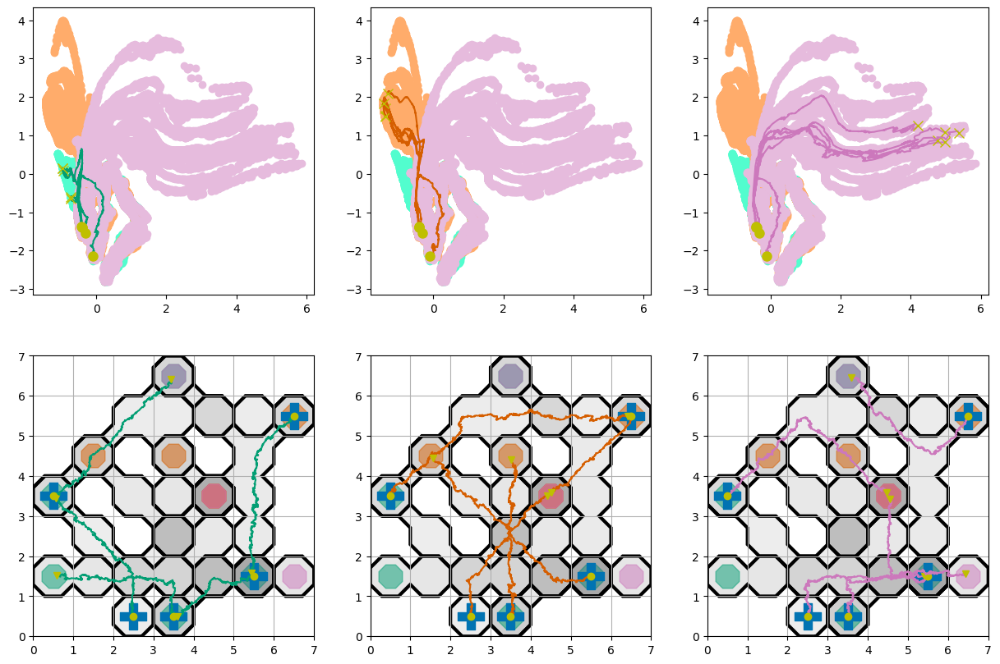

In [29]:
###GRAPH
plt.figure()
fig, axs = plt.subplots(2, 3, figsize = (15, 10))

for g in range(3): #goal edge
    idx_g = np.where(edge_g == g)
    for m in range(3):        
        im = axs[0, m].scatter(latent_space_g_2d[idx_g, 0], latent_space_g_2d[idx_g, 1], alpha = 1, color = lighten_color(col[g+2]))

    for k in range(n_maze): #maze config
        traj_act_latent = extract_lat_space_trajectory(traj_g, goal=g, maze_config=k, pc=placeCells_g, model= graph_model)
        traj_act_latent= pca_g.transform(traj_act_latent.detach().numpy())

        axs[0, g].plot(traj_act_latent[:, 0], traj_act_latent[:, 1], label = "maze %s, goal %s"%(k, g), c=col[g+2])
        axs[0, g].plot(traj_act_latent[0, 0], traj_act_latent[0, 1], 'yo', markersize = 8)
        axs[0, g].plot(traj_act_latent[-1, 0], traj_act_latent[-1, 1], 'yx',  markersize = 8)

        traj_x_array, traj_y_array = extract_maze_trajectory(traj_g, g, k)
        ax_plot_traj(axs[1, g], traj_x_array, traj_y_array, maze, k, traj_col = col[g+2])#, maze_color = colors[k])

        #patch = patches.PathPatch(maze.trialOctoMaze[k], facecolor='None', lw=3)
        #axs[1, g].add_patch(patch)
        ax_plot_maze(axs[1, g], maze, k)



# Generalization

### Euclidean dataset

In [30]:
#discretize 2d space
D=1000
xv, yv = np.meshgrid(np.linspace(0, 7, D), np.linspace(0, 7, D))
x = np.dstack((xv, yv)).reshape(D*D, 2)

col = np.zeros((3,x.shape[0]))
col[0, :] =  x[:, 0]
col[2, :] =  x[:, 1]
col = col/7

In [31]:
nu = placeCells_e.fire(maze, 0, x.T)
nu = preprocessing(nu, placeCells_e)
X_out_latent = eucl_model.encoder(torch.Tensor(nu)).detach().numpy()
X_2d = pca_e.transform(X_out_latent)

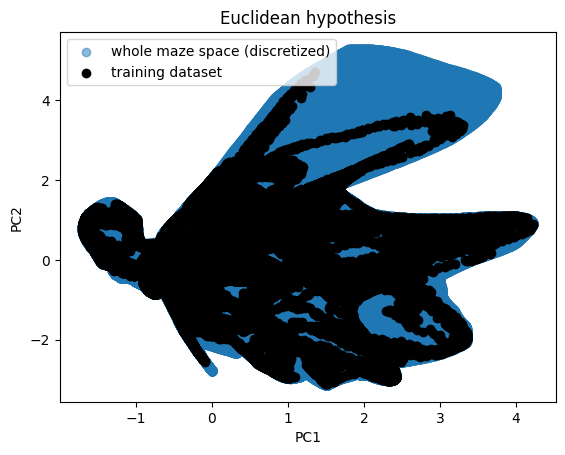

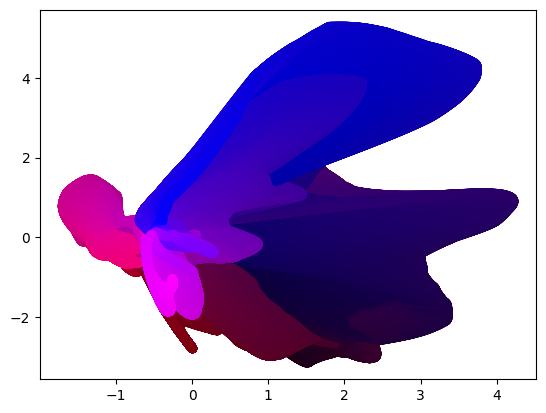

In [33]:
plt.scatter(X_2d[:, 0], X_2d[:, 1], label = "whole maze space (discretized)", alpha = 0.5)
plt.scatter(latent_space_e_2d[:, 0], latent_space_e_2d[:, 1], c="k", label='training dataset')
plt.title("Euclidean hypothesis")
plt.xlabel("PC1")
plt.ylabel("PC2")

plt.legend(loc = "upper left")
plt.show()
plt.scatter(X_2d[:, 0], X_2d[:, 1], label = "whole maze space (discretized)", c=col.T)


### graph dataset

In [36]:
idx_maze0 = np.where(maze.trialMazeFlags[0].T==True)
x = np.vstack((idx_maze0[0], idx_maze0[1]))/100

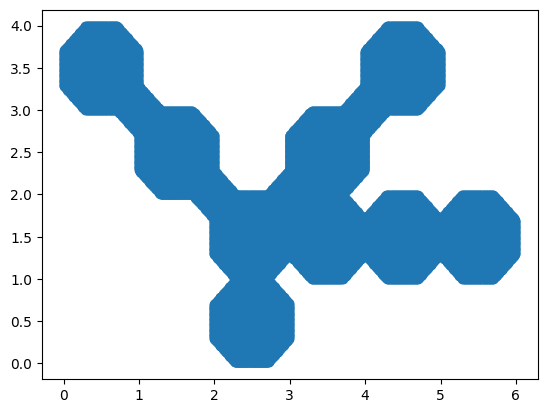

In [37]:
plt.scatter(x[0, :], x[1, :])

In [38]:
nu = placeCells_g.fire(maze, 0, x)
nu = preprocessing(nu, placeCells_g)
X_out_latent = graph_model.encoder(torch.Tensor(nu)).detach().numpy()
X_2d = pca_g.transform(X_out_latent)

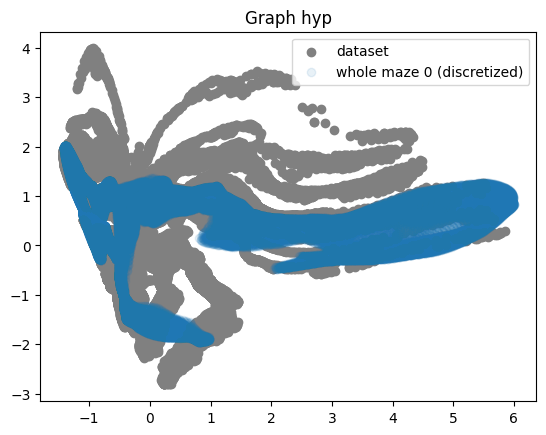

In [39]:
plt.title("Graph hyp")
plt.scatter(latent_space_g_2d[:, 0], latent_space_g_2d[:, 1], c="grey", label='dataset')
plt.scatter(X_2d[:, 0], X_2d[:, 1], label = "whole maze 0 (discretized)", alpha = 0.1)
plt.legend(loc = "upper right" )

In [40]:
idx_maze5 = np.where(maze.trialMazeFlags[5].T==True)
x = np.vstack((idx_maze5[0], idx_maze5[1]))/100

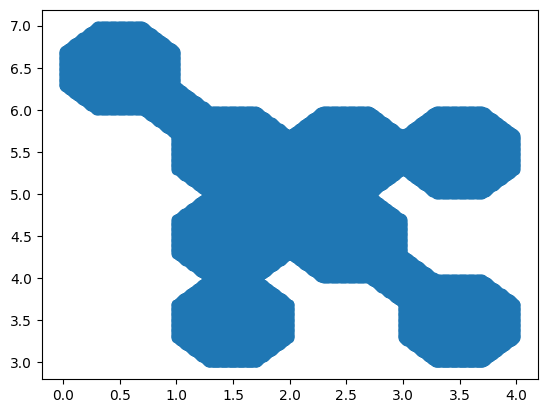

In [41]:
plt.scatter(x[0, :], x[1, :])

In [42]:
nu = placeCells_g.fire(maze, 5, x)
nu = preprocessing(nu, placeCells_g)
X_out_latent = graph_model.encoder(torch.Tensor(nu)).detach().numpy()
X_2d = pca_g.transform(X_out_latent)

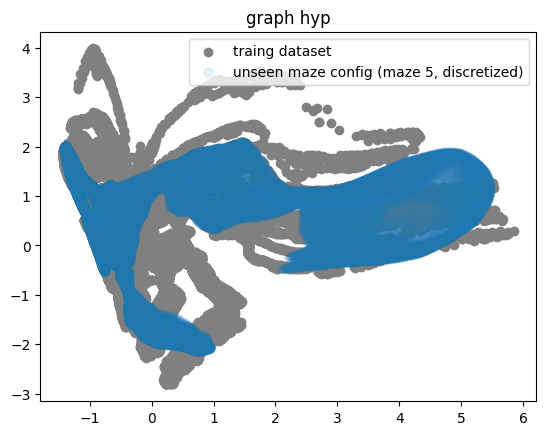

In [43]:
plt.title("graph hyp")
plt.scatter(latent_space_g_2d[:, 0], latent_space_g_2d[:, 1], c="grey", label='traing dataset')
plt.scatter(X_2d[:, 0], X_2d[:, 1], label = "unseen maze config (maze 5, discretized)", alpha = 0.1)
plt.legend(loc = "upper right" )

In [44]:
i = traj_g.traj_cut_idx[89]
j = traj_g.traj_cut_idx[90]
new_traj = np.array([traj_g.x_traj[i:j], traj_g.y_traj[i:j]])

nu = placeCells_g.fire(maze, 5, new_traj)
nu = preprocessing(nu, placeCells_g)

X_new = graph_model.encoder(torch.Tensor(nu)).detach().numpy()
X_new_2d = pca_g.transform(X_new)

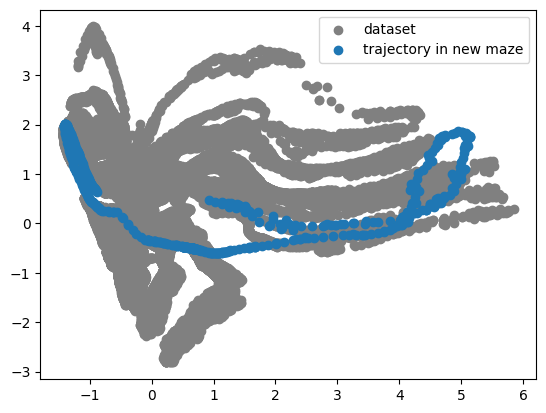

In [46]:
plt.scatter(latent_space_g_2d[:, 0], latent_space_g_2d[:, 1], c="grey", label='dataset')

plt.scatter(X_new_2d[:, 0], X_new_2d[:, 1], label = "trajectory in new maze")
plt.legend()


# 3D plots

In [49]:
def f(vn, x, y, k=0):
    z = (-vn[0]*x - vn[1]*y -k)/vn[2]
    
    return z
    

In [50]:
xx, yy = np.meshgrid(np.linspace(-100, 100, 10), np.linspace(-100, 100, 10))

v1 = pca_e.components_[1, :]
v2 = pca_e.components_[0, :]
vn = np.cross(v1, v2)
vn
z = f(vn, xx, yy, 0)

In [51]:
import plotly.express as px
import pandas as pd
import plotly.graph_objects as go

d = np.linalg.norm(traj_tot_e.T - np.array([[0,0]]).T, axis = 0)
df = pd.DataFrame(latent_space_e)
df = df.rename(columns={'0': 'dim1', '1': 'dim2', "2":"dim3"})
df["Euclidean distance from home"] = d

#df = df.sample(n=200000)
col = np.zeros((3, df.index.shape[0]))
col[0, :] =  traj_tot_e[df.index, 0]
col[2, :] =  traj_tot_e[df.index, 1]
col = col/7*256


marker_dict = dict(size=3,
        color= [f'rgb({col[0, i]}, {col[1, i]}, {col[2, i]})' for i in range(col.shape[1])],  # set color to an array/list of desired values
        opacity=0.8)
fig = go.Figure(data=[go.Surface(z=z, x=xx[0, :], y=yy[:, 0], surfacecolor = np.zeros(10), opacity = 0.4)] )
fig.add_scatter3d(x=df[0], y=df[1], z=df[2],mode='markers', marker=marker_dict) #, color = "Euclidean distance from home", title = "Euclidean Hyp: latent space" )

fig.update_layout(
    scene = dict(
        xaxis = dict(nticks=4, range=[df[0].min(),df[0].max()],),
                     yaxis = dict(nticks=4, range=[df[1].min(),df[1].max()],),
                     zaxis = dict(nticks=4, range=[df[2].min(),df[2].max()],),),
    width=700,
    margin=dict(r=20, l=10, b=10, t=10))
#cbar = fig.colorbar(im, ax = axs[0])
#cbar.set_label("Eucl dist from origin")

fig.show()

In [52]:
import plotly.express as px
import pandas as pd
import plotly.graph_objects as go

d = np.linalg.norm(traj_tot_e.T - np.array([[0,0]]).T, axis = 0)
df = pd.DataFrame(latent_space_e)
df = df.rename(columns={'0': 'dim1', '1': 'dim2', "2":"dim3"})
df["Relative graph distance from home"] = dge

#df = df.sample(n=200000)
df = df.sample(frac = 1)


marker_dict = dict(size=3,
        color=df["Relative graph distance from home"],  # set color to an array/list of desired values
        colorscale='Aggrnyl',   # choose a colorscale
        opacity=0.8)

fig = go.Figure(data=[go.Surface(z=z, x=xx[0, :], y=yy[:, 0], surfacecolor = np.zeros(10), opacity = 0.4)] )
fig.add_scatter3d(x=df[0], y=df[1], z=df[2],mode='markers', marker=marker_dict) #, color = "Euclidean distance from home", title = "Euclidean Hyp: latent space" )

fig.update_layout(
    scene = dict(
        xaxis = dict(nticks=4, range=[df[0].min(),df[0].max()],),
                     yaxis = dict(nticks=4, range=[df[1].min(),df[1].max()],),
                     zaxis = dict(nticks=4, range=[df[2].min(),df[2].max()],),),
    width=700,
    margin=dict(r=20, l=10, b=10, t=10))
#cbar = fig.colorbar(im, ax = axs[0])
#cbar.set_label("Eucl dist from origin")

fig.show()

In [ ]:
xx, yy = np.meshgrid(np.linspace(-100, 100, 10), np.linspace(-100, 100, 10))

v1 = pca_g.components_[1, :]
v2 = pca_g.components_[0, :]
vn = np.cross(v1, v2)
vn
z = f(vn, xx, yy, 0)

In [ ]:
import plotly.express as px
import pandas as pd
import plotly.graph_objects as go
col = np.zeros((3, traj_tot_g.shape[0]))
col[0, :] =  traj_tot_g[:, 0]
col[2, :] =  traj_tot_g[:,1]
col = col/7

d = np.linalg.norm(traj_tot_g.T - np.array([[0,0]]).T, axis = 0)
df = pd.DataFrame(latent_space_g)
df = df.rename(columns={'0': 'dim1', '1': 'dim2', "2":"dim3"})
df["Euclidean distance from home"] = d

#df = df.sample(n=100000)

marker_dict = dict(size=3,
        color=df["Euclidean distance from home"],  # set color to an array/list of desired values
        colorscale=['blue', 'purple',  'black', 'red'],   # choose a colorscale
        opacity=0.8)

fig = go.Figure(data=[go.Surface(z=z, x=xx[0, :], y=yy[:, 0], surfacecolor = np.zeros(10), opacity = 0.4)] )
fig.add_scatter3d(x=df[0], y=df[1], z=df[2],mode='markers', marker=marker_dict) #, color = "Euclidean distance from home", title = "Euclidean Hyp: latent space" )

fig.update_layout(
    scene = dict(
        xaxis = dict(nticks=4, range=[df[0].min(),df[0].max()],),
                     yaxis = dict(nticks=4, range=[df[1].min(),df[1].max()],),
                     zaxis = dict(nticks=4, range=[df[2].min(),df[2].max()],),),
    width=700,
    margin=dict(r=20, l=10, b=10, t=10))
#cbar = fig.colorbar(im, ax = axs[0])
#cbar.set_label("Eucl dist from origin")

fig.show()

In [ ]:
import plotly.express as px
import pandas as pd
import plotly.graph_objects as go

d = np.linalg.norm(traj_tot_g.T - np.array([[0,0]]).T, axis = 0)
df = pd.DataFrame(latent_space_g)
df = df.rename(columns={'0': 'dim1', '1': 'dim2', "2":"dim3"})
df["Relative graph distance from home"] = dgg

#df = df.sample(n=100000)

marker_dict = dict(size=3,
        color=df["Relative graph distance from home"],  # set color to an array/list of desired values
        colorscale='Viridis',   # choose a colorscale
        opacity=0.8)

fig = go.Figure(data=[go.Surface(z=z, x=xx[0, :], y=yy[:, 0], surfacecolor = np.zeros(10), opacity = 0.4)] )
fig.add_scatter3d(x=df[0], y=df[1], z=df[2],mode='markers', marker=marker_dict) #, color = "Euclidean distance from home", title = "Euclidean Hyp: latent space" )

fig.update_layout(
    scene = dict(
        xaxis = dict(nticks=4, range=[df[0].min(),df[0].max()],),
                     yaxis = dict(nticks=4, range=[df[1].min(),df[1].max()],),
                     zaxis = dict(nticks=4, range=[df[2].min(),df[2].max()],),),
    width=700,
    margin=dict(r=20, l=10, b=10, t=10))
#cbar = fig.colorbar(im, ax = axs[0])
#cbar.set_label("Eucl dist from origin")

fig.show()

## Proximity graphs

In [53]:
def lineseg_dists(p, a, b):
    """Cartesian distance from point to line segment

    Edited to support arguments as series, from:
    https://stackoverflow.com/a/54442561/11208892

    Args:
        - p: np.array of single point, shape (2,) or 2D array, shape (x, 2)
        - a: np.array of shape (x, 2)
        - b: np.array of shape (x, 2)
    """
    # normalized tangent vectors
    d_ba = b - a
    d = np.divide(d_ba, (np.hypot(d_ba[:, 0], d_ba[:, 1])
                           .reshape(-1, 1)))

    # signed parallel distance components
    # rowwise dot products of 2D vectors
    s = np.multiply(a - p, d).sum(axis=1)
    t = np.multiply(p - b, d).sum(axis=1)

    # clamped parallel distance
    h = np.maximum.reduce([s, t, np.zeros(len(s))])

    # perpendicular distance component
    # rowwise cross products of 2D vectors  
    d_pa = p - a
    c = d_pa[:, 0] * d[:, 1] - d_pa[:, 1] * d[:, 0]

    return np.hypot(h, c)

def project(p, a, b):
    
    n = a - b
    n /= np.linalg.norm(n, 2)
    
    P = a + n*np.dot(p - a, n)
    
    return P

def graph_rel_dist(x, y, maze, cfgs_x, cfgs_y):
    #x and y are two arrays of points
    h = np.empty([maze.nb_of_trials, 2])
    c = np.empty([maze.nb_of_trials, 2])
    g0 = np.empty([maze.nb_of_trials, 2])
    g1 = np.empty([maze.nb_of_trials, 2])
    g2 = np.empty([maze.nb_of_trials, 2]) #pt/xORy/coord
    
    #extract relevant tiles for each pair of points
    for i in range(maze.nb_of_trials):
        h[i] = np.array(maze.nodeList[i]["A"])+0.5
        c[i] = np.array(maze.nodeList[i]["B"])+0.5
        g0[i] = np.array(maze.nodeList[i]["C"])+0.5
        g1[i] = np.array(maze.nodeList[i]["D"])+0.5
        g2[i] = np.array(maze.nodeList[i]["E"])+0.5

    maze_edges_v = np.array([h, g0, g1, g2])
    print(maze_edges_v.shape)
    
    #compute edge belongings for each pair of points
    d2seg_x = np.empty([x.shape[0], 4])
    d2seg_y = np.empty([y.shape[0], 4])
    
    for i in range(x.shape[0]):
        cfg_x = cfgs_x[i]
        cfg_y = cfgs_y[i]
        d2seg_x[i, :] = lineseg_dists(x[i, :], np.array([c[cfg_x], c[cfg_x], c[cfg_x], c[cfg_x]]),
                                      np.array([h[cfg_x], g0[cfg_x], g1[cfg_x], g2[cfg_x]]))
        d2seg_y[i, :] = lineseg_dists(y[i, :], np.array([c[cfg_y], c[cfg_y], c[cfg_y], c[cfg_y]]), 
                                      np.array([h[cfg_y], g0[cfg_y], g1[cfg_y], g2[cfg_y]]))
        
      
        print(str(i) + "/" + str(x.shape[0]))
    edge_bel_x = np.argmin(d2seg_x, axis = -1)
    edge_bel_y = np.argmin(d2seg_y, axis = -1)

    proj_x = np.empty([x.shape[0], 2])
    proj_y = np.empty([y.shape[0], 2])
    
    for i in range(x.shape[0]):
        cfg_x = cfgs_x[i]
        cfg_y = cfgs_y[i]
        proj_x[i, :] = project(x[i, :], maze_edges_v[edge_bel_x[i], cfg_x, :], c[cfg_x])
        proj_y[i, :] = project(y[i, :], maze_edges_v[edge_bel_y[i], cfg_y, :], c[cfg_y])
        print(str(i) + "/" + str(x.shape[0]))
    
    rel_pos_x = np.empty(x.shape[0])
    rel_pos_y = np.empty(y.shape[0])
    for i in range(x.shape[0]):
        cfg_x = cfgs_x[i]
        cfg_y = cfgs_y[i]
        rel_pos_x[i] = np.linalg.norm(c[cfg_x] - proj_x[i])/np.linalg.norm(c[cfg_x]-maze_edges_v[edge_bel_x[i], cfg_x,:])
        rel_pos_y[i] = np.linalg.norm(c[cfg_y] - proj_y[i])/np.linalg.norm(c[cfg_y]-maze_edges_v[edge_bel_y[i], cfg_y,:])
        print(str(i) + "/" + str(x.shape[0]))
    
  
    graph_rel_dist = np.empty(rel_pos_x.shape[0])

    idx_eq = np.where(edge_bel_x == edge_bel_y)[0]
    if idx_eq.size != 0:
        graph_rel_dist[idx_eq] = np.abs(rel_pos_x[idx_eq]-rel_pos_y[idx_eq])

    idx_neq = np.where(edge_bel_x != edge_bel_y)[0]
    if idx_neq.size != 0:
        graph_rel_dist[idx_neq] = np.abs(rel_pos_x[idx_neq]) + np.abs(rel_pos_y[idx_neq])


    
    return graph_rel_dist

In [54]:
import plotly.express as px
import plotly.graph_objects as go

In [ ]:
SAMPLE_SIZE = 10000


corr_e1 = []
corr_e2 = []
corr_g1 = []
corr_g2 = []

for i in range(100):
    le = pd.DataFrame(latent_space_e)
    le_sample_1 = le.sample(n=SAMPLE_SIZE)
    le_sample_2 = le.sample(n=SAMPLE_SIZE)

    lg = pd.DataFrame(latent_space_g)
    lg_sample_1 = lg.sample(n=SAMPLE_SIZE)
    lg_sample_2 = lg.sample(n=SAMPLE_SIZE)

    pos_e = pd.DataFrame(traj_tot_e)
    pos_e_sample_1 = pos_e.loc[le_sample_1.index]
    pos_e_sample_2 = pos_e.loc[le_sample_2.index]

    pos_g = pd.DataFrame(traj_tot_g)
    pos_g_sample_1 = pos_g.loc[lg_sample_1.index]
    pos_g_sample_2 = pos_g.loc[lg_sample_2.index]

    cfg_g = pd.DataFrame(maze_config_g)
    cfg_e = pd.DataFrame(maze_config_e)

    cfg_g_1 = cfg_g.loc[lg_sample_1.index]
    cfg_g_2 = cfg_g.loc[lg_sample_2.index]
    cfg_e_1 = cfg_e.loc[le_sample_1.index]
    cfg_e_2 = cfg_e.loc[le_sample_2.index]
    ################
    eucl_dist_pos_e = np.linalg.norm(pos_e_sample_1.to_numpy() - pos_e_sample_2.to_numpy(), axis=1)
    eucl_dist_pos_g = np.linalg.norm(pos_g_sample_1.to_numpy() - pos_g_sample_2.to_numpy(), axis=1)
    eucl_dist_le = np.linalg.norm(le_sample_1.to_numpy() - le_sample_2.to_numpy(), axis=1)
    eucl_dist_lg = np.linalg.norm(lg_sample_1.to_numpy() - lg_sample_2.to_numpy(), axis=1)
    
    x = pos_e_sample_1.to_numpy()
    y = pos_e_sample_2.to_numpy()
    gdist_ehyp = graph_rel_dist(x, y, maze, cfg_e_1[0].to_numpy().astype(int), cfg_e_2[0].to_numpy().astype(int))
    
    x = pos_g_sample_1.to_numpy()
    y = pos_g_sample_2.to_numpy()
    gdist_ghyp = graph_rel_dist(x, y, maze, cfg_g_1[0].to_numpy().astype(int), cfg_g_2[0].to_numpy().astype(int))
    
    
    ##correlation
    
    corr_e1.append(np.corrcoef(gdist_ghyp, eucl_dist_lg)[1, 0])
    corr_e2.append(np.corrcoef(eucl_dist_pos_g, eucl_dist_lg)[1, 0])
    corr_g1.append(np.corrcoef(gdist_ehyp, eucl_dist_le)[1, 0])
    corr_g2.append(np.corrcoef(eucl_dist_pos_e, eucl_dist_le)[1, 0])


In [ ]:
print(np.mean(corr_e1))
print(np.std(corr_e1))

In [ ]:
print(np.mean(corr_e2))
print(np.std(corr_e2))

In [ ]:
print(np.mean(corr_g1))
print(np.std(corr_g1))

In [ ]:
print(np.mean(corr_g2))
print(np.std(corr_g2))

In [ ]:
np.max(corr_g2)

In [ ]:
def density_fig(x, y):

    t = np.linspace(-1, 1.2, 2000)
    a, b = np.polyfit(x, y, 1)
    
    fig = go.Figure()
    fig.add_trace(go.Histogram2dContour(
            x = x,
            y = y,
            colorscale = 'Blues',
            reversescale = False,
            xaxis = 'x',
            yaxis = 'y', 
        zmax = 300, 
        zmin = 0
        ))
    fig.add_trace(go.Scatter(
            x = x,
            y = y,
            xaxis = 'x',
            yaxis = 'y',
            mode = 'markers',
            marker = dict(
                color = 'rgba(0, 0, 0, 0.1)',
                size = 3
            )
        ))
    
    fig.add_trace(go.Scatter(
            x = x,
            y = a*x+b,
            xaxis = 'x',
            yaxis = 'y',
            mode = 'lines',
            marker = dict(
                color = 'rgba(0, 0, 0, 1)',
                size = 3
            )
        ))

    fig.update_layout(
        autosize = False,
        xaxis = dict(
            zeroline = False,
            domain = [0,0.85],
            showgrid = False
        ),
        yaxis = dict(
            zeroline = False,
            domain = [0,0.85],
            showgrid = False
        ),
        xaxis2 = dict(
            zeroline = False,
            domain = [0.85,1],
            showgrid = False
        ),
        yaxis2 = dict(
            zeroline = False,
            domain = [0.85,1],
            showgrid = False
        ),
        height = 600,
        width = 600,
        bargap = 0,
  hovermode = 'closest',
        showlegend = False
    )

    return fig

In [ ]:
fig = density_fig(gdist_ghyp, eucl_dist_lg)
fig.write_image("prox_g2_AE_noise.pdf")

fig.show()
np.corrcoef(gdist_ghyp, eucl_dist_lg)

In [ ]:
fig = density_fig(eucl_dist_pos_g, eucl_dist_lg)
fig.write_image("prox_g1_AE_noise.pdf")

fig.show()
np.corrcoef(eucl_dist_pos_g, eucl_dist_lg)

In [ ]:
fig = density_fig(gdist_ehyp, eucl_dist_le)
fig.write_image("prox_e2_AE_noise.pdf")

fig.show()
np.corrcoef(gdist_ehyp, eucl_dist_le)

In [ ]:
fig = density_fig(eucl_dist_pos_e, eucl_dist_le)
fig.write_image("prox_e1_AE_noise.pdf")

fig.show()
np.corrcoef(eucl_dist_pos_e, eucl_dist_le)